In [16]:
import sys
sys.path.append('/data1/caption_bias/models/research/im2txt/coco-caption/')
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap
import numpy as np
from bias_detection import *
import json
import os
import nltk
import random
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage import io


In [21]:
expt_name = 'balanced_captions'
save_file = '/home/lisaanne/lev//data2/kaylee/caption_bias/models/research/im2txt/captions/balanced_captions.json'
predicted_captions = json.load(open(save_file))

coco = COCO('coco/annotations/captions_val2014.json')
generation_coco = coco.loadRes(save_file)
coco_evaluator = COCOEvalCap(coco, generation_coco)
coco_evaluator.evaluate()

loading annotations into memory...
0:00:00.530564
creating index...
index created!
Loading and preparing results...     
DONE (t=0.16s)
creating index...
index created!
tokenization...
setting up scorers...
computing Bleu score...
{'reflen': 383148, 'guess': [384605, 344101, 303597, 263093], 'testlen': 384605, 'correct': [232641, 98709, 42146, 19564]}
ratio: 1.00380270809
Bleu_1: 0.605
Bleu_2: 0.417
Bleu_3: 0.289
Bleu_4: 0.206
computing METEOR score...
METEOR: 0.196
computing Rouge score...
ROUGE_L: 0.451
computing CIDEr score...
CIDEr: 0.588


In [14]:
im_id_to_url = {}

for image in coco.dataset['images']:
    im_id_to_url[image['id']] = image['coco_url']
    
im_id_to_annotations = {}

for annotation in coco.dataset['annotations']:
    if annotation['image_id'] not in im_id_to_annotations:
        im_id_to_annotations[annotation['image_id']] = []
    im_id_to_annotations[annotation['image_id']].append(annotation)

20/40504

/home/lisaanne/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


499/40504

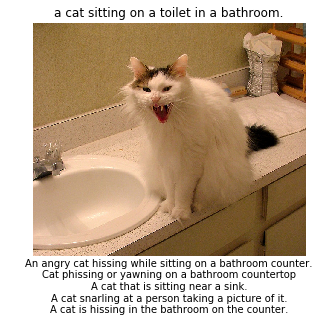

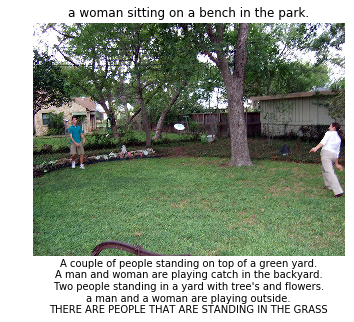

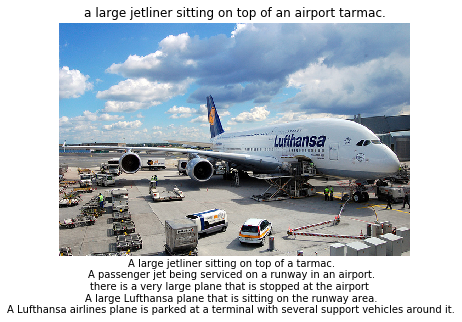

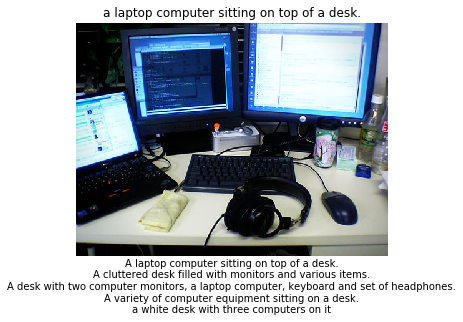

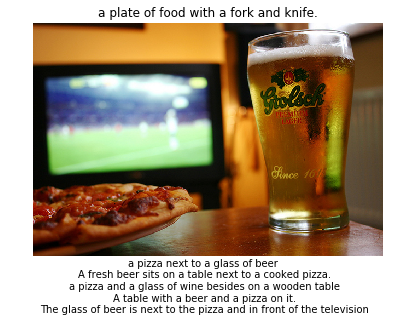

...

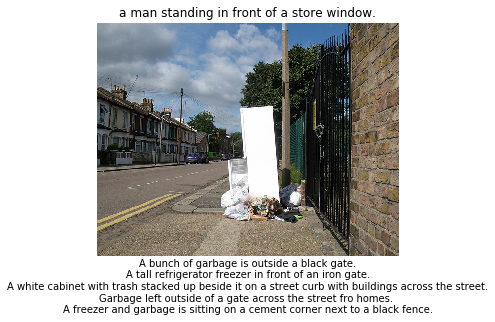

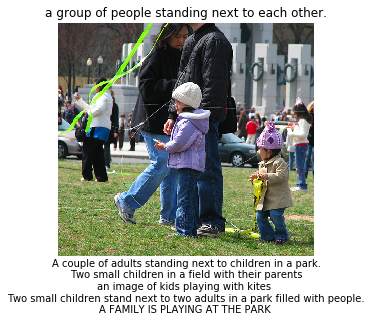

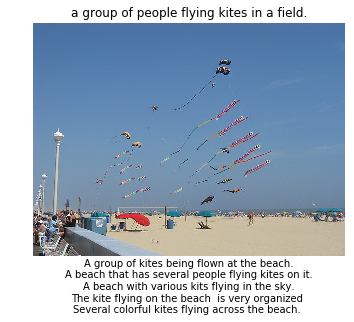

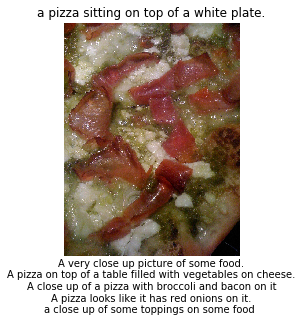

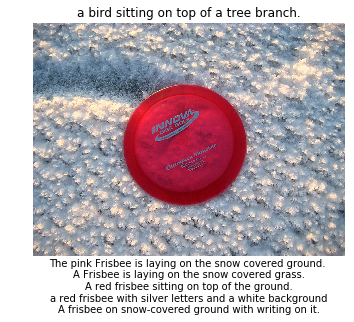

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


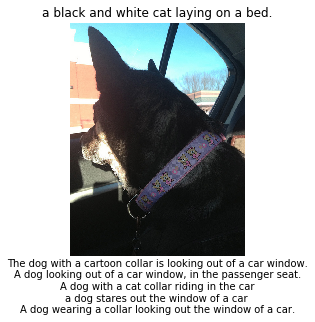

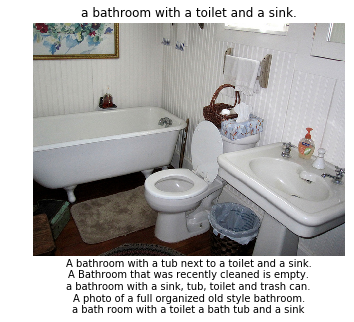

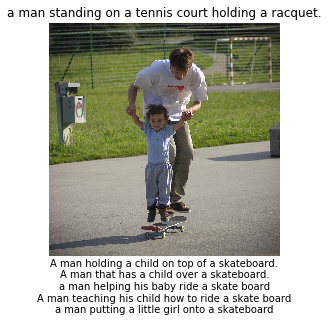

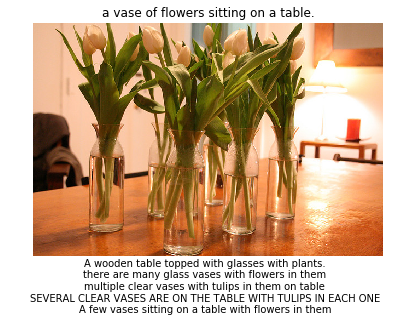

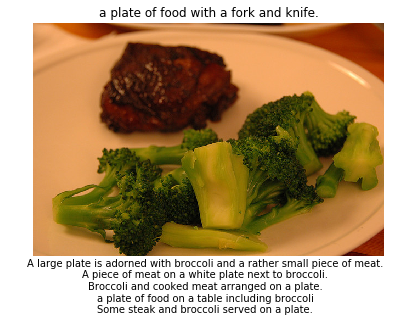

...

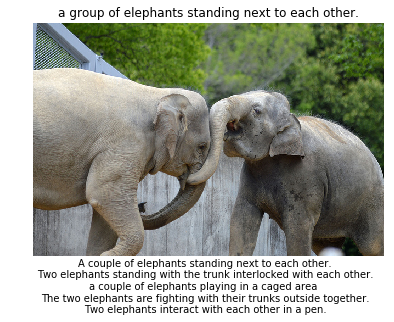

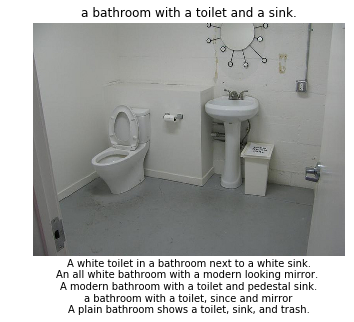

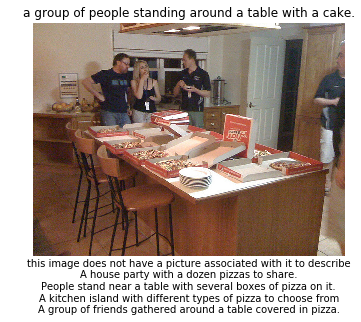

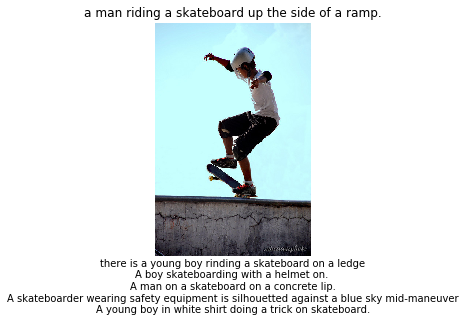

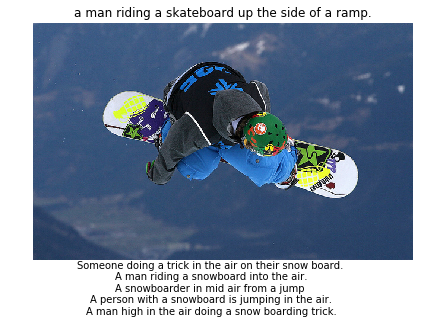

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


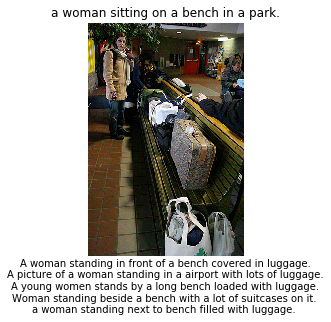

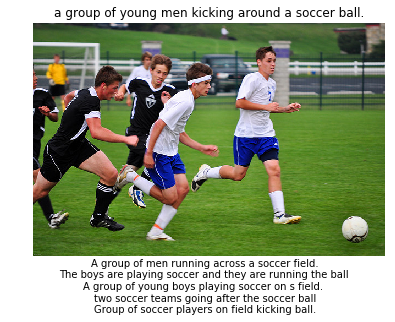

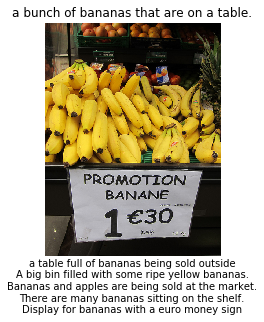

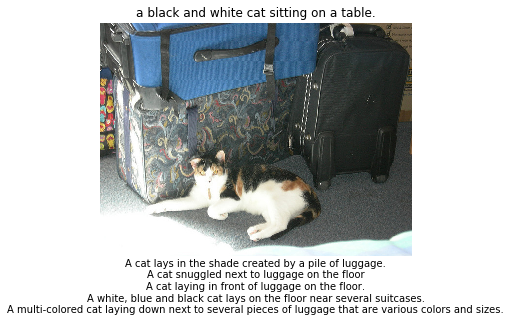

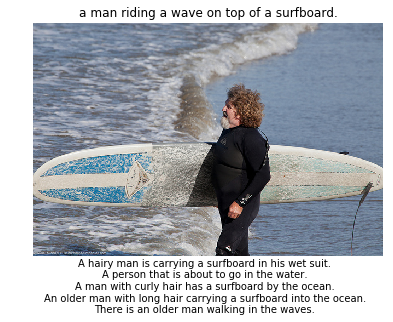

...

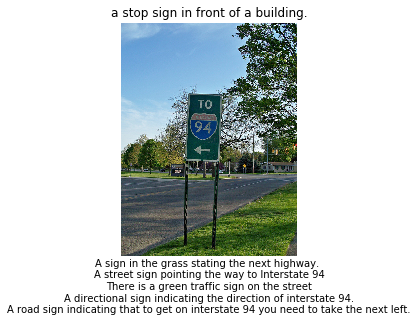

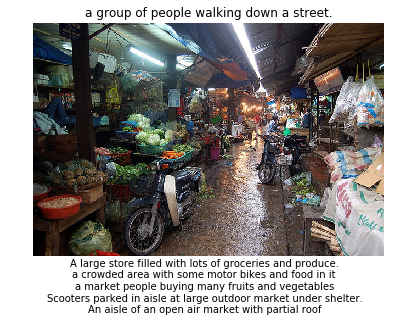

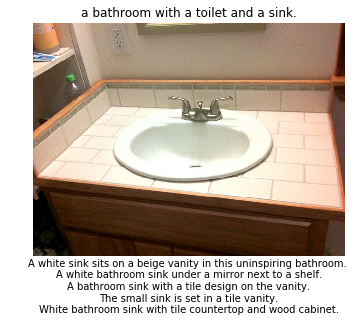

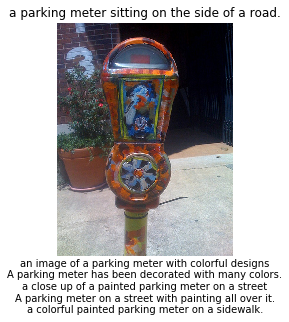

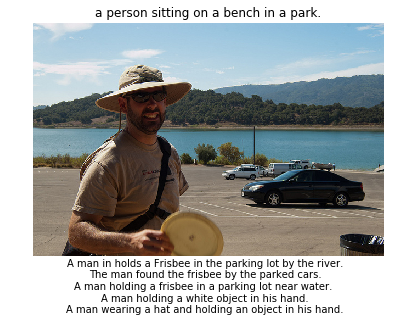

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


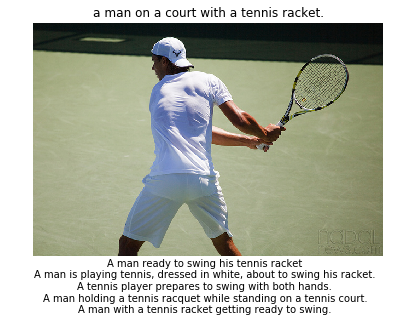

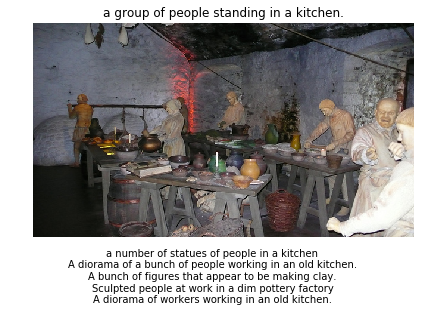

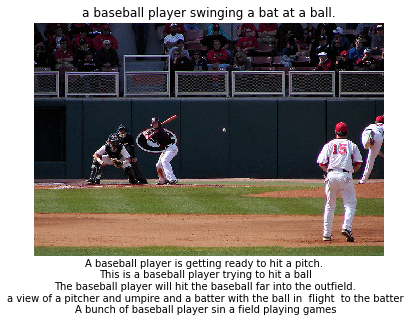

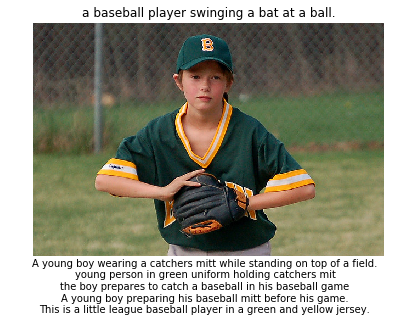

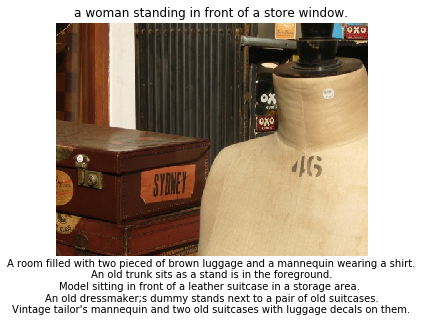

...

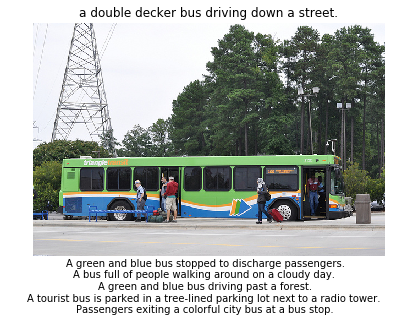

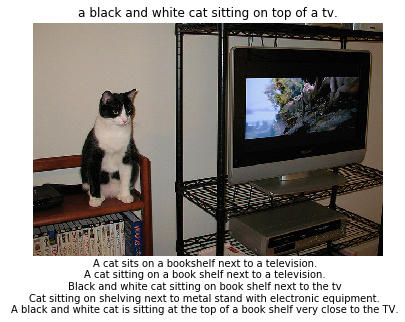

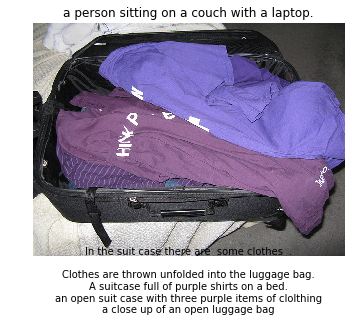

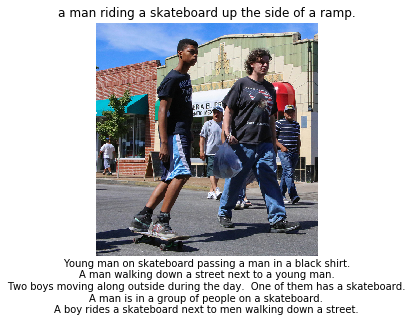

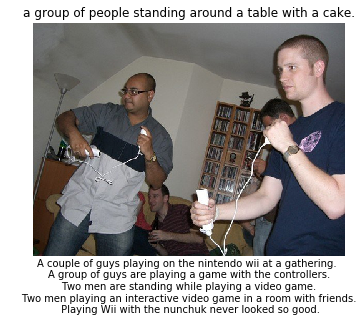

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


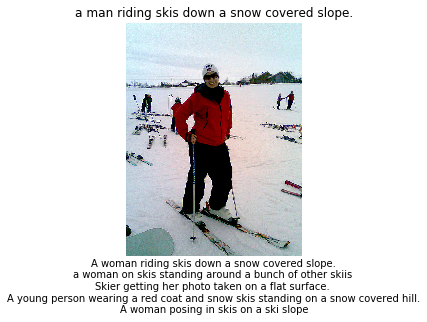

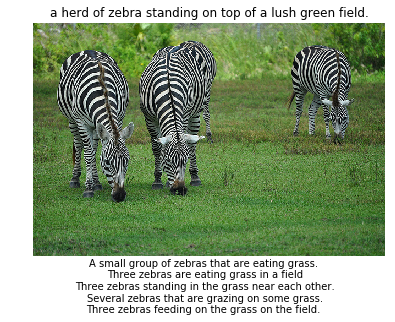

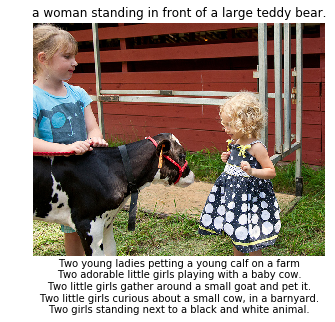

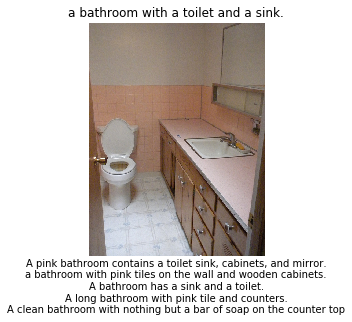

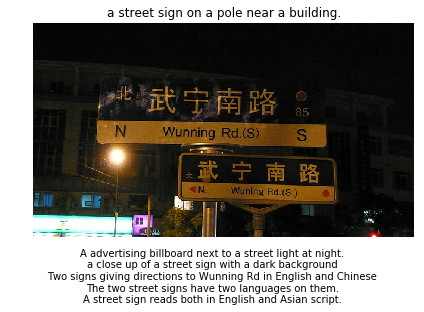

...

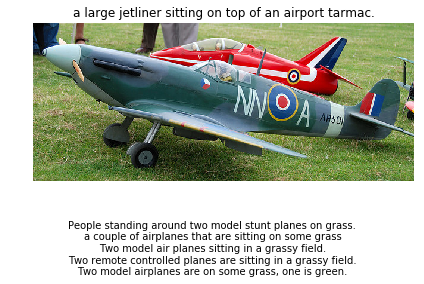

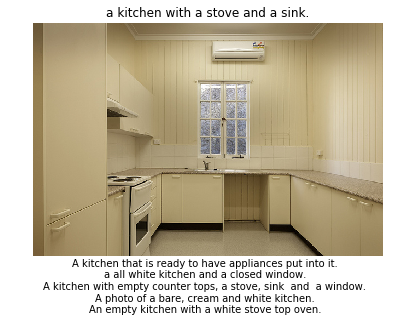

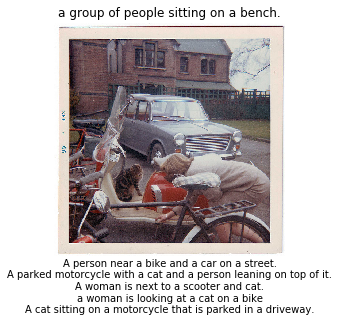

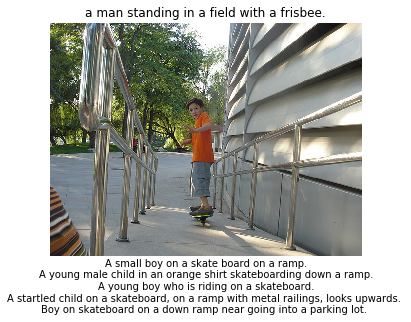

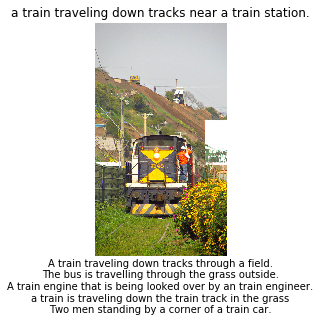

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


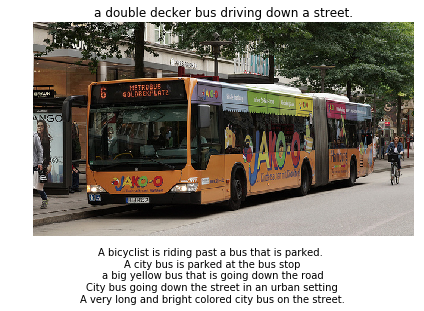

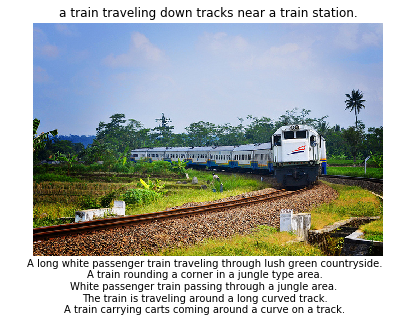

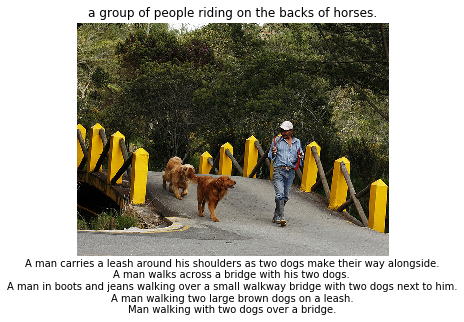

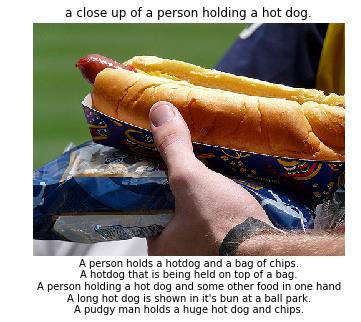

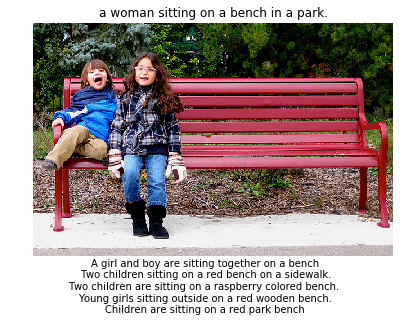

...

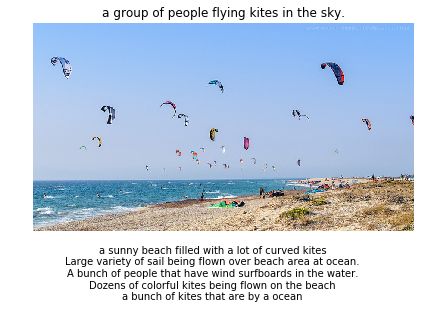

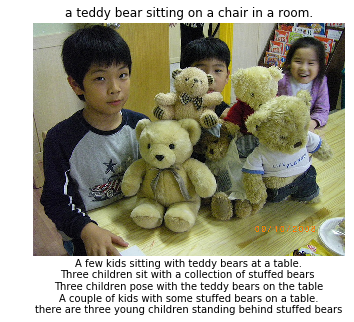

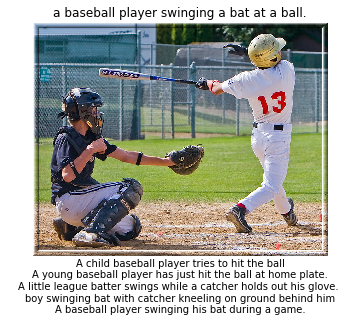

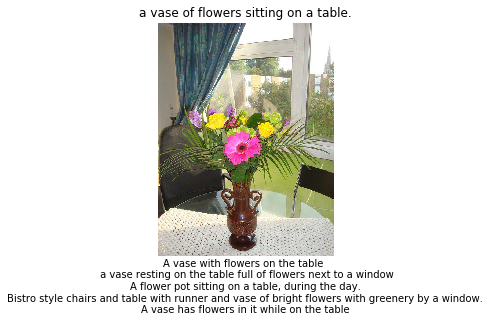

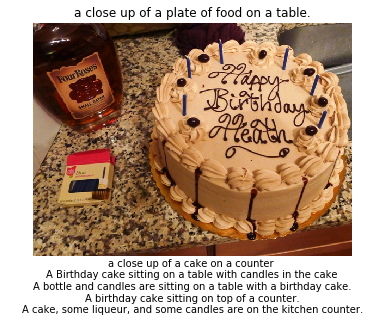

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


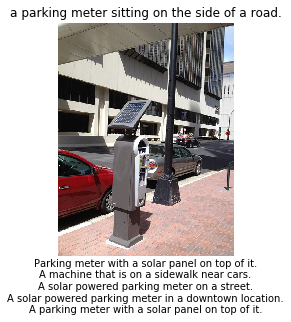

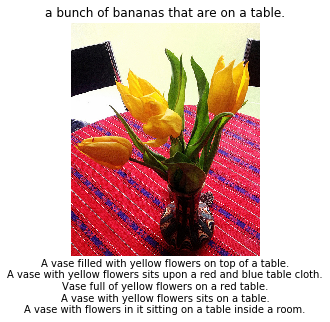

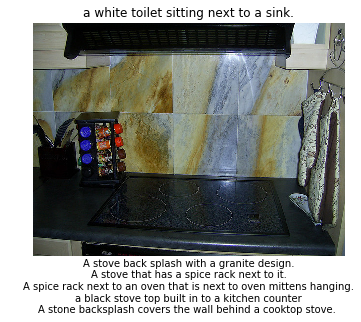

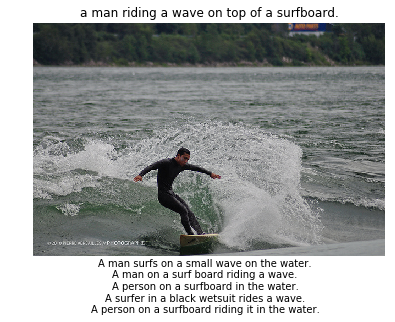

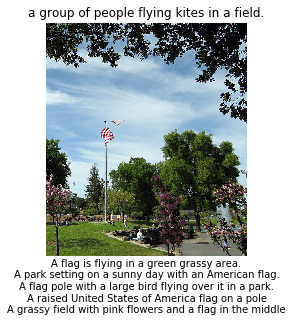

...

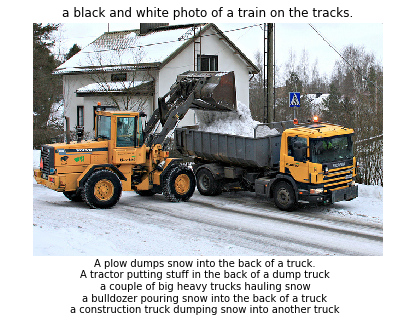

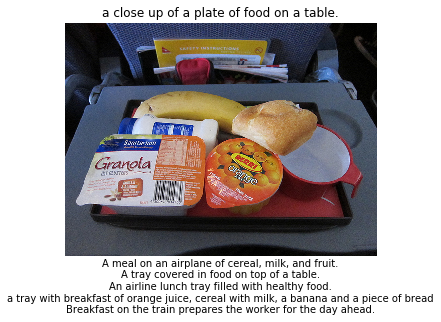

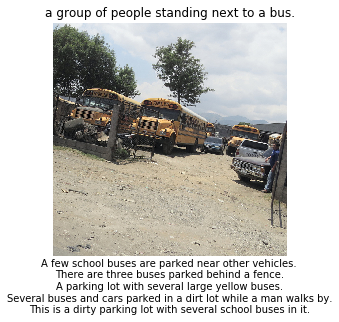

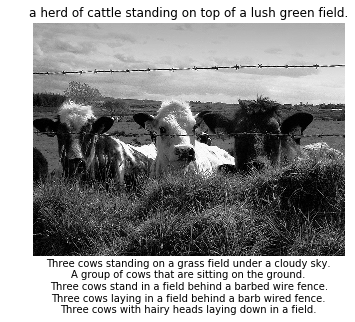

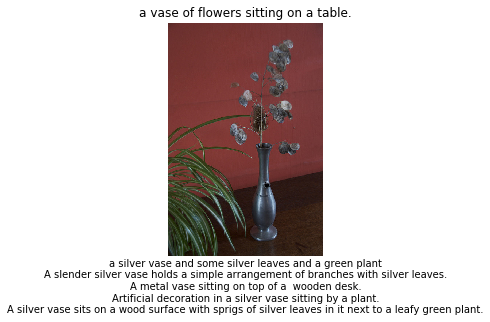

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


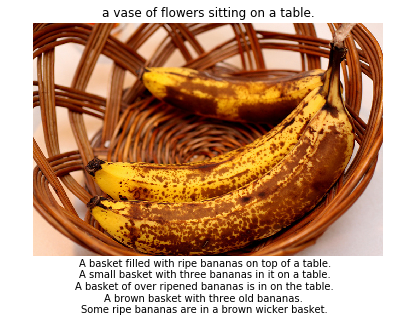

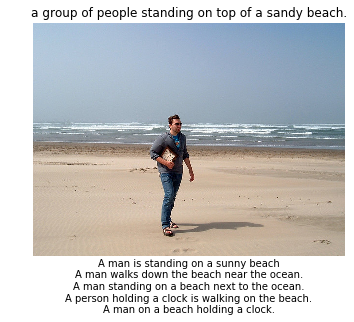

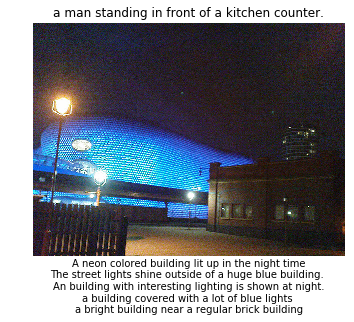

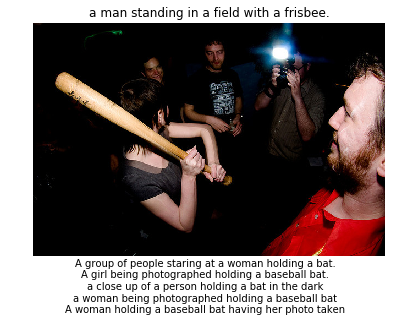

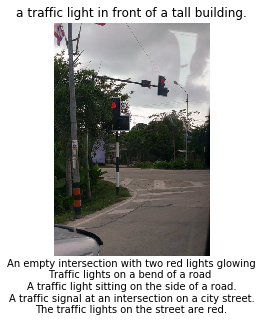

...

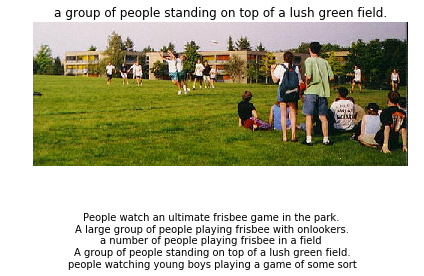

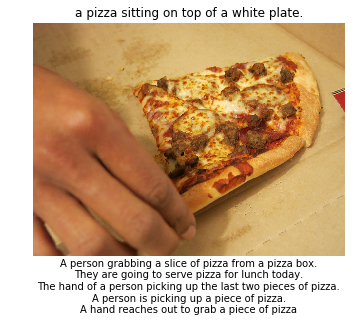

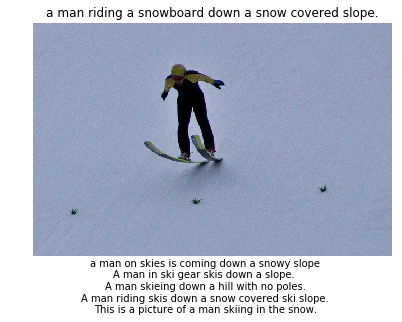

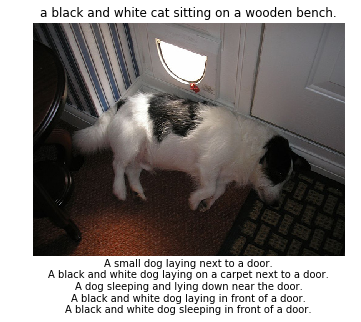

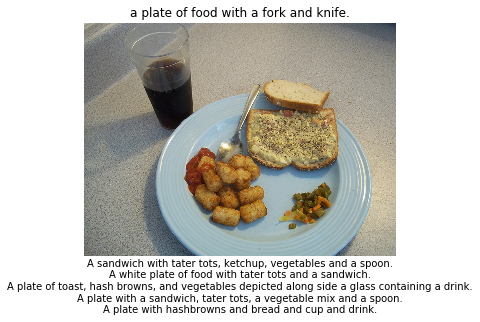

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


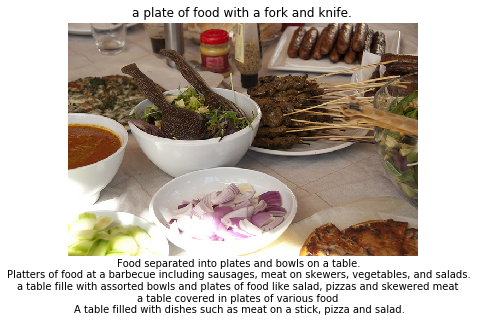

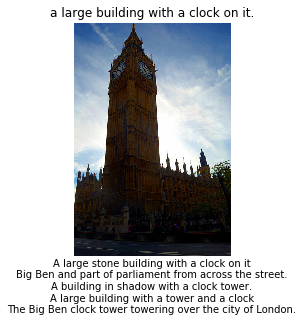

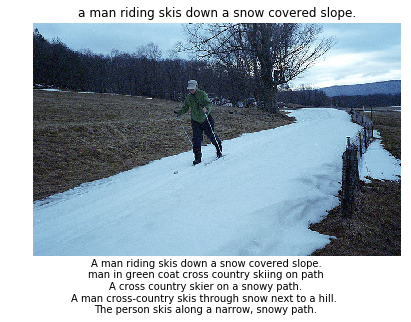

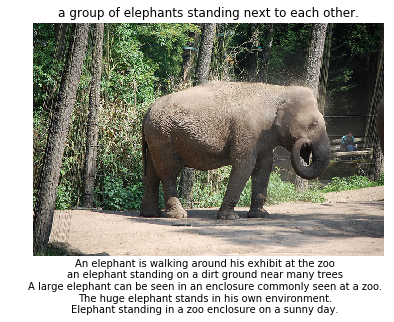

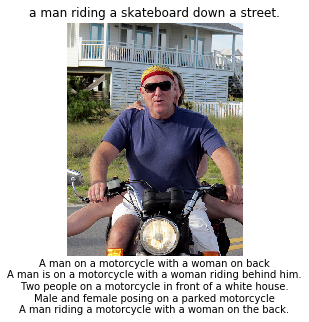

...

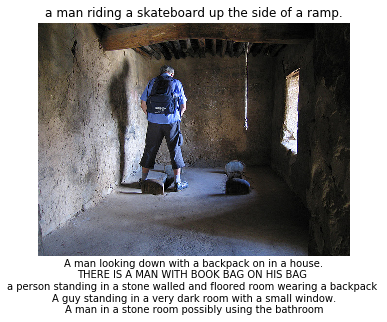

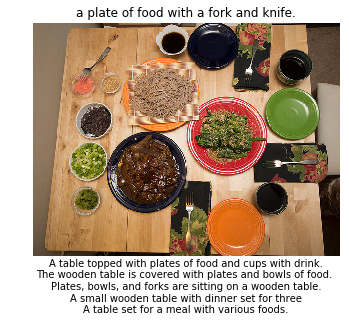

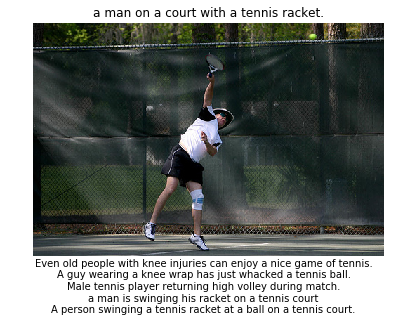

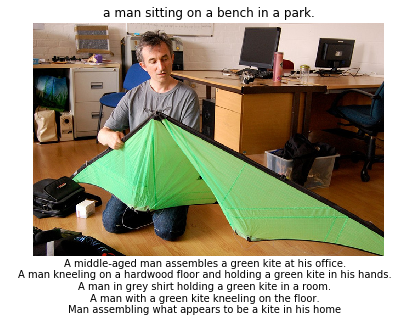

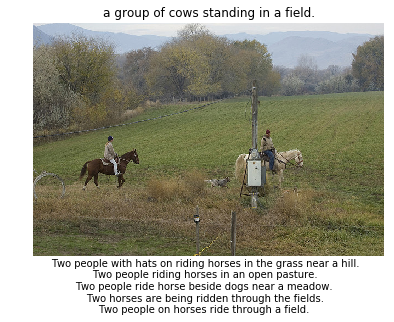

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


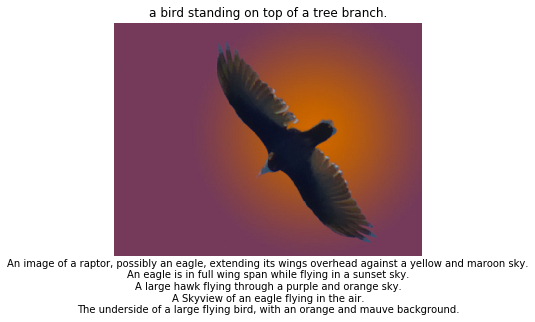

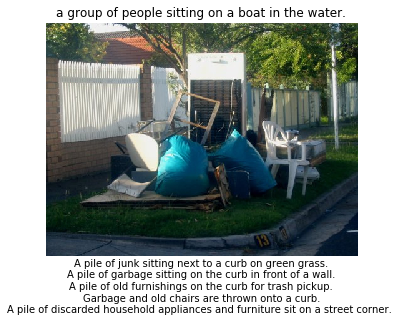

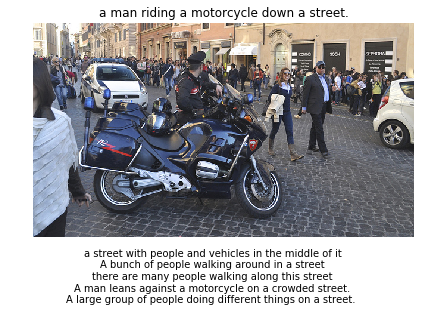

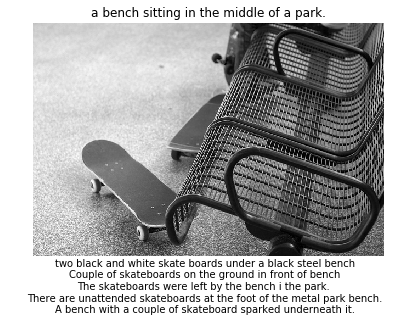

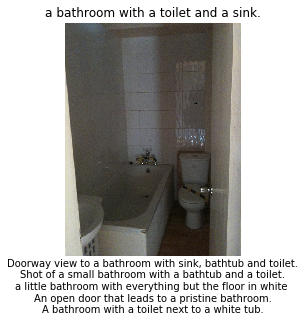

...

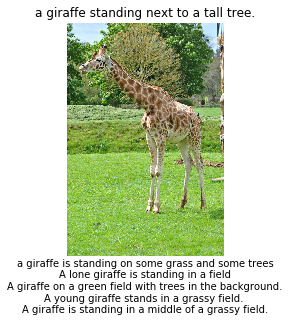

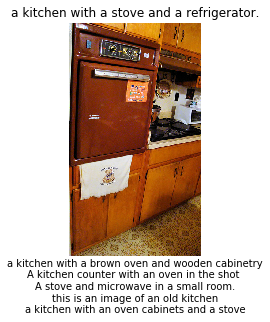

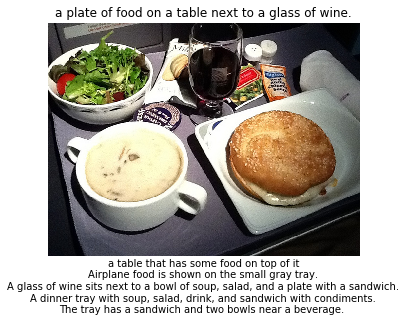

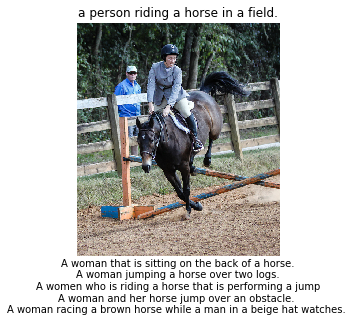

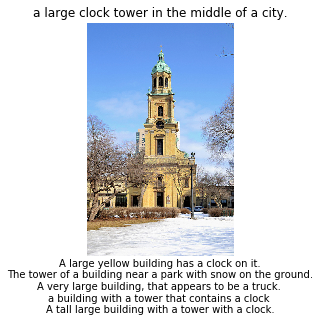

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


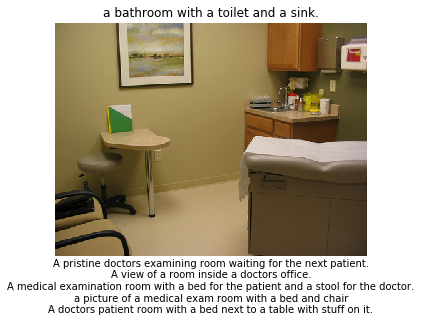

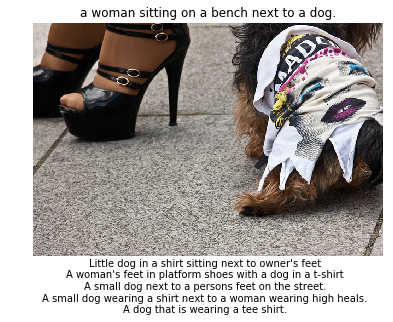

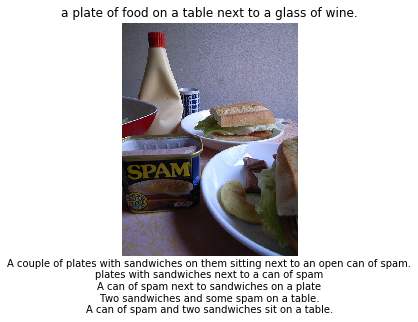

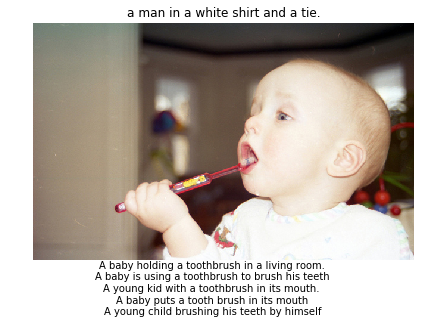

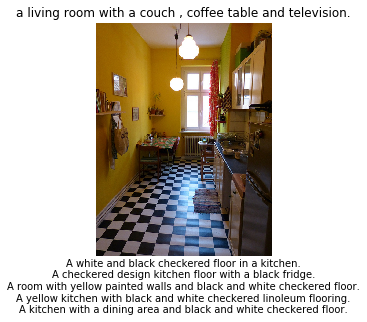

...

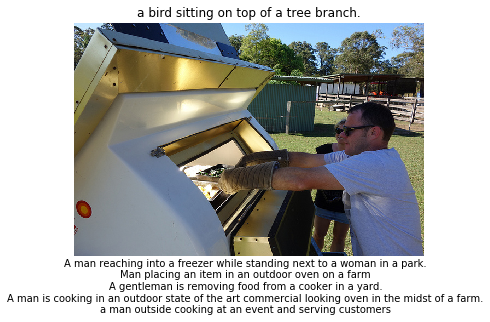

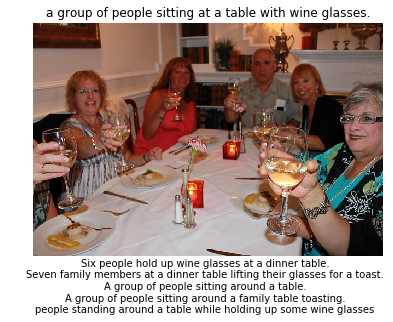

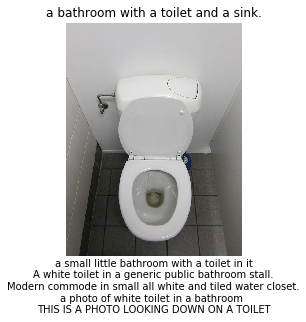

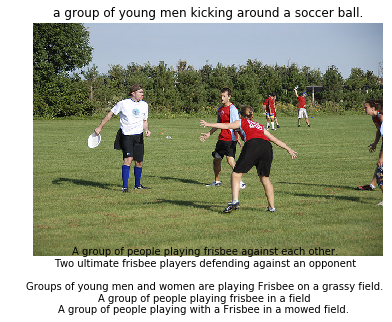

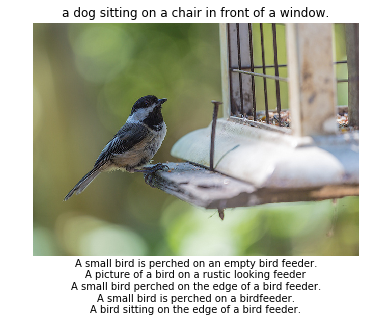

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


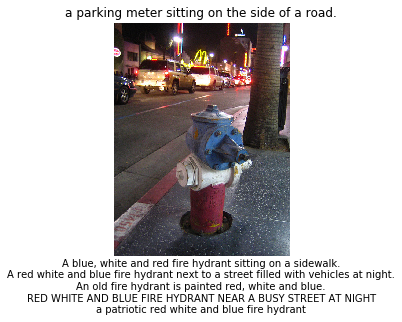

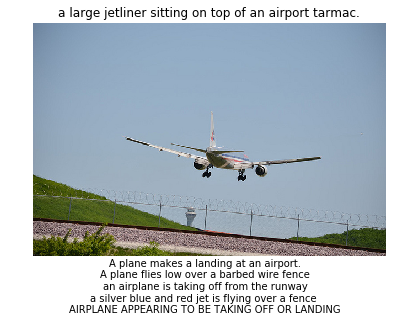

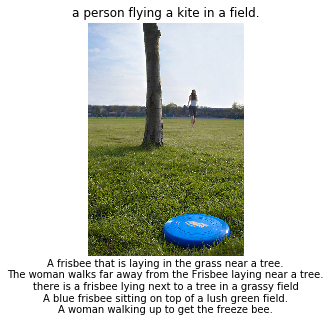

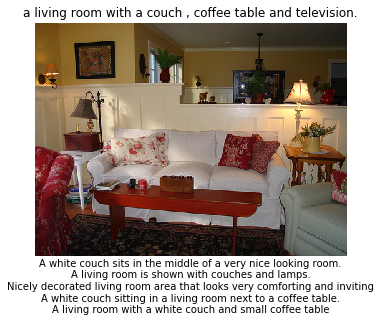

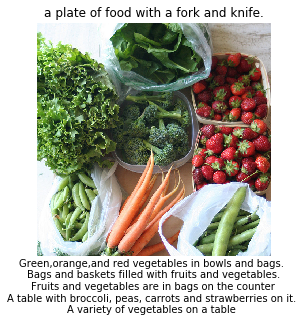

...

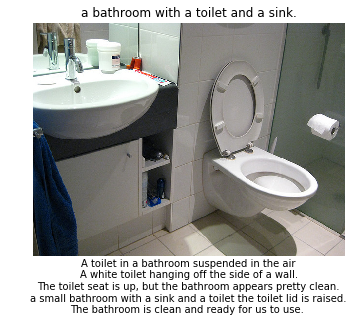

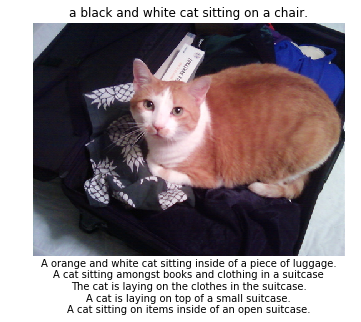

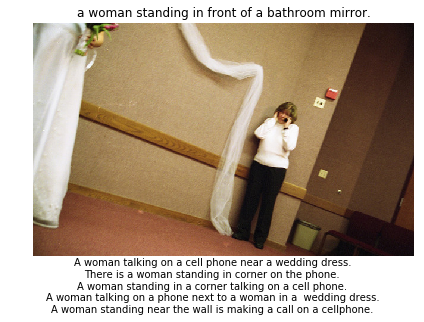

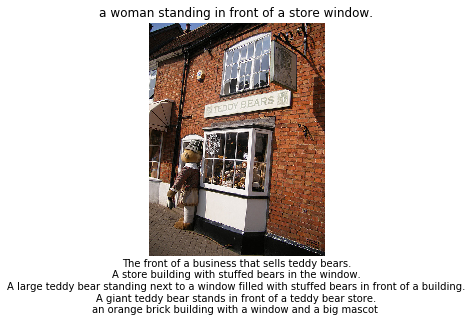

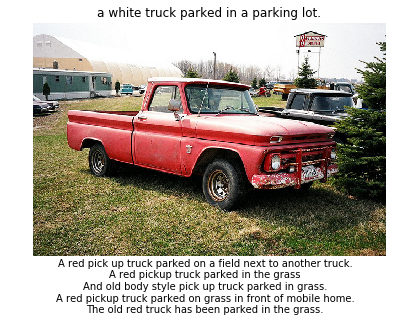

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


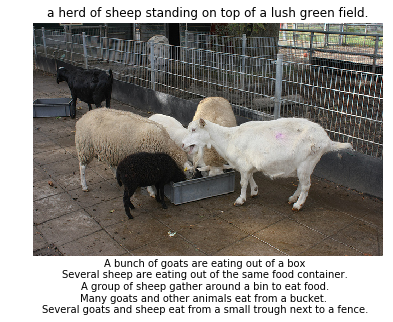

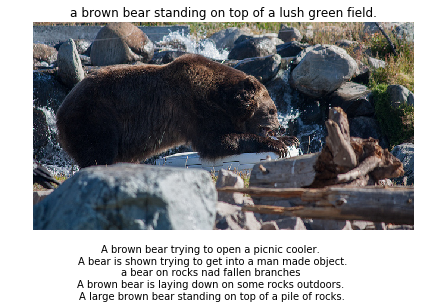

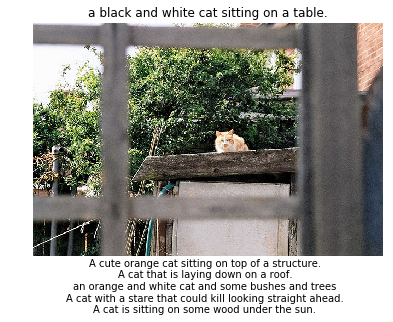

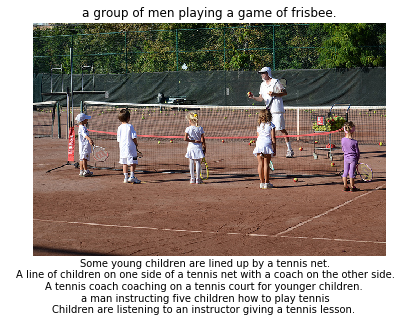

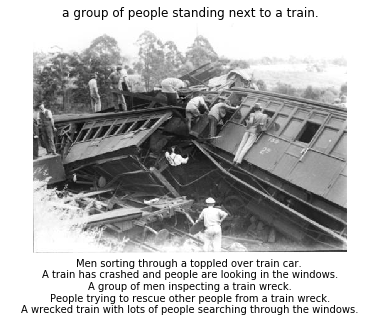

...

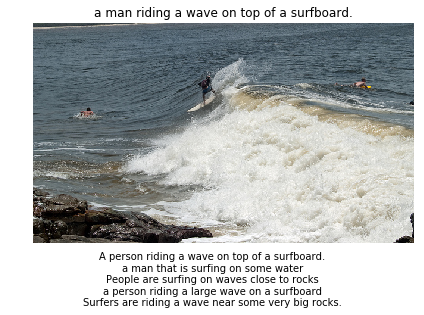

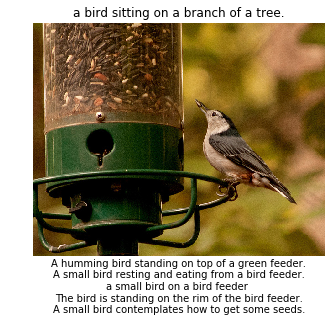

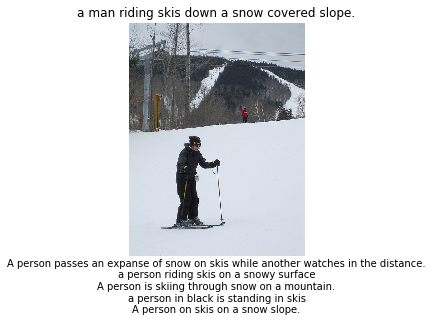

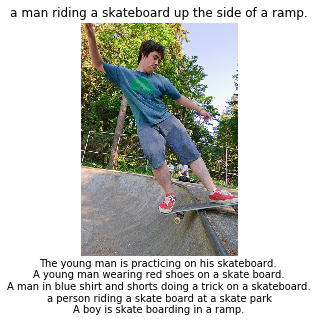

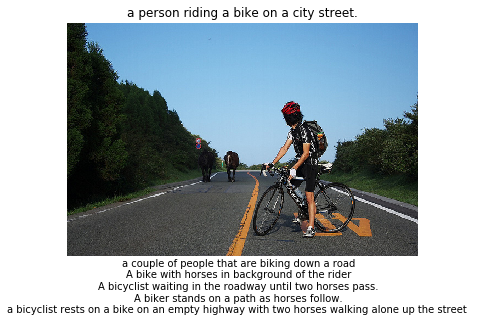

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


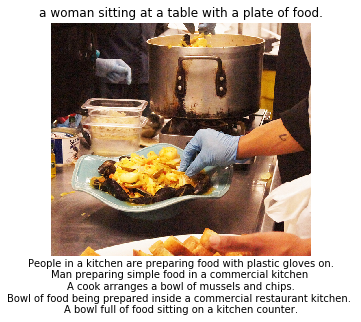

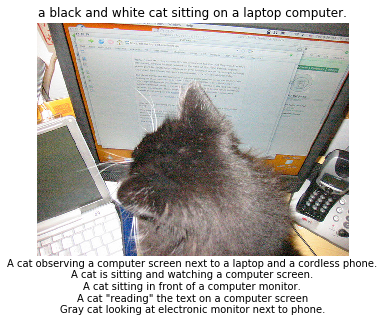

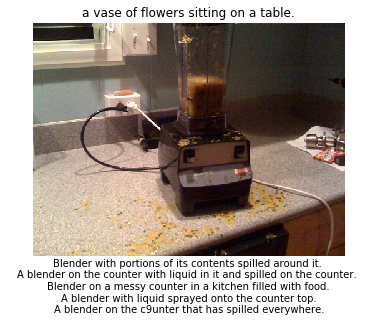

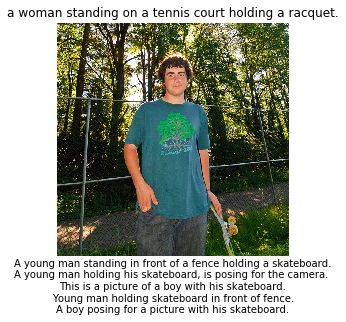

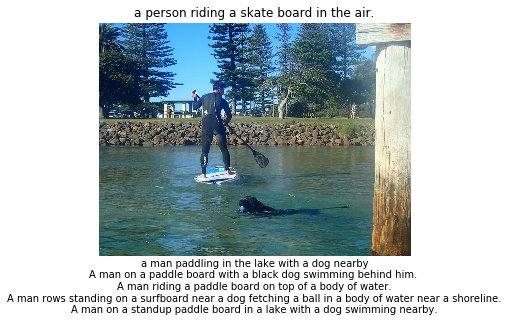

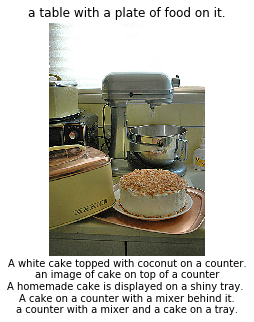

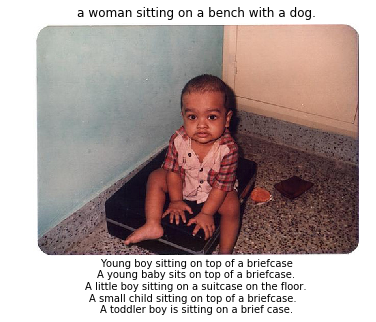

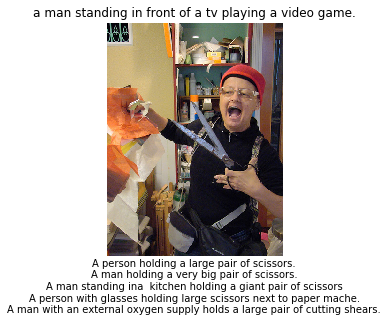

In [19]:
save_folder_base = '/home/lisaanne/lev/data2/caption-bias/outputs/'
save_folder = save_folder_base + '%s/%%s/%%012d.png' %expt_name

from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

if not os.path.exists('%s/%s/' %(save_folder_base, expt_name)):
    os.mkdir('%s/%s/' %(save_folder_base, expt_name))
    os.mkdir('%s/%s/' %(save_folder_base, expt_name) + '/all-sents')

random.shuffle(predicted_captions)
    
for i, prediction in enumerate(predicted_captions[:500]):
    sys.stdout.write('\r%d/%d' %(i, len(predicted_captions)))
    caption = prediction['caption']
    img_id = prediction['image_id']
    tag = 'all-sents'
            
    url = im_id_to_url[img_id]
    fig = plt.figure()
    image = io.imread(url)
    gt_annotations = [anno['caption'] for anno in im_id_to_annotations[img_id]]
    plt.imshow(image)
    plt.axis('off')
    plt.title(caption)
    
    txt = '\n'.join(gt_annotations)
    fig.text(.5, -.1, txt, ha='center')
    fig.savefig(save_folder %(tag, img_id), bbox_inches="tight")

In [20]:
len(predicted_captions)

40504